In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import cPickle as pickle
from preprocess import prep_injury
from matplotlib import rcParams
rcParams.update({'figure.autolayout': True})
import re
import seaborn as sns
from sklearn.cross_validation import train_test_split

%matplotlib inline

In [3]:
def clean_notes(x):
    found = re.findall(r'\s\(\w\)', x)
    if found:
        return x.replace(found[0], '')
    else:
        return x

def parse_date(df, date_col, create_sep_cols=True):
    df[date_col] = pd.to_datetime(df[date_col], infer_datetime_format=True)
    if create_sep_cols:
        date = df[date_col]
        df['YEAR'] = date.apply(lambda x: x.year)
        df['MONTH'] = date.apply(lambda x: x.month)
        df['DAY'] = date.apply(lambda x: x.day)
    return df

    
    
# preprocess injury df
def prep_injury(df):

    # converting the Date column to datetime objects
    df = parse_date(df, 'Date')

    # filter out all events not directly related to basketball
    df = df[(~df['Notes'].str.contains('flu')) &
#             (~df['Notes'].str.contains('rest')) &
            (~df['Notes'].str.contains('jail')) &
            (~df['Notes'].str.contains('ill')) &
            (~df['Notes'].str.contains('asthma')) &
            (~df['Notes'].str.contains('virus')) &
            (~df['Notes'].str.contains('return')) &
            (~df['Notes'].str.contains('pneumonia')) &
            (~df['Notes'].str.contains('coach')) &
            (~df['Notes'].str.contains('sister')) &
            (~df['Notes'].str.contains('Fined')) &
            (~df['Notes'].str.contains('flu')) &
            (~df['Notes'].str.contains('GM')) &
            (~df['Notes'].str.contains('flu')) &
            (~df['Notes'].str.contains('team')) &
            (~df['Notes'].str.contains('canal')) &
            (~df['Notes'].str.contains('food')) &
            (~df['Notes'].str.contains('virus')) &
            (~df['Notes'].str.contains('wife')) &
            (~df['Notes'].str.contains('asthma')) &
            (~df['Notes'].str.contains('chin')) &
            (~df['Notes'].str.contains('headache')) &
            (~df['Notes'].str.contains('anemia')) &
            (~df['Notes'].str.contains('dizziness')) &
            (~df['Notes'].str.contains('cold')) &
            (~df['Notes'].str.contains('throat')) &
            (~df['Notes'].str.contains('molar')) &
            (~df['Notes'].str.contains('dizziness')) &
            (~df['Notes'].str.contains('rash')) &
            (~df['Notes'].str.contains('stomach ache')) &
            (~df['Notes'].str.contains('bronchitis')) &
            (~df['Notes'].str.contains('concussion')) &
            (~df['Notes'].str.contains('recover')) &
            (~df['Notes'].str.contains('mump'))]

    # clean notes
    df['Notes'] = df['Notes'].apply(clean_notes)

    # stripping blank spaces from player names
    df['Player'] = df['Player'].apply(lambda x: x.strip())

    # removing periods from names like C.J.
    df['Player'] = df['Player'].apply(lambda x: ''.join(x.split('.'))
                                                if re.match(r'\w\.\w\.', x)
                                                else x)

    # removing characters like (a) and (b)
    df['Player'] = df['Player'].apply(lambda x: ' '.join(x.split()[:2])
                                                if re.match(r'.+\(.+\)', x)
                                                else x)

    # manually correcting Tony Parker's name
    df[df['Player'] == '(William) Tony Parker']['Player'] = 'Tony Parker'
    df = df[df['Player'] != '']


    # renames the injury df columns
    df.rename(columns={'Player': 'Player_Injury', 'Date': 'Date_Injury'},
              inplace=True)

    return df

In [4]:
injury_df = pd.read_csv('data/injuries.csv', usecols=range(1, 5))
injury_df = prep_injury(injury_df)

/home/peter/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:62: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/home/peter/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:65: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/home/peter/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:68: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable

In [5]:
injury_df['REST'] = injury_df['Notes'].apply(lambda x: 1 if 'rest' in x else 0)
injury_df['INJURED'] = injury_df['REST'].apply(lambda x: 1 if x == 0 else 0)

In [6]:
grouped = injury_df.groupby('YEAR').sum()

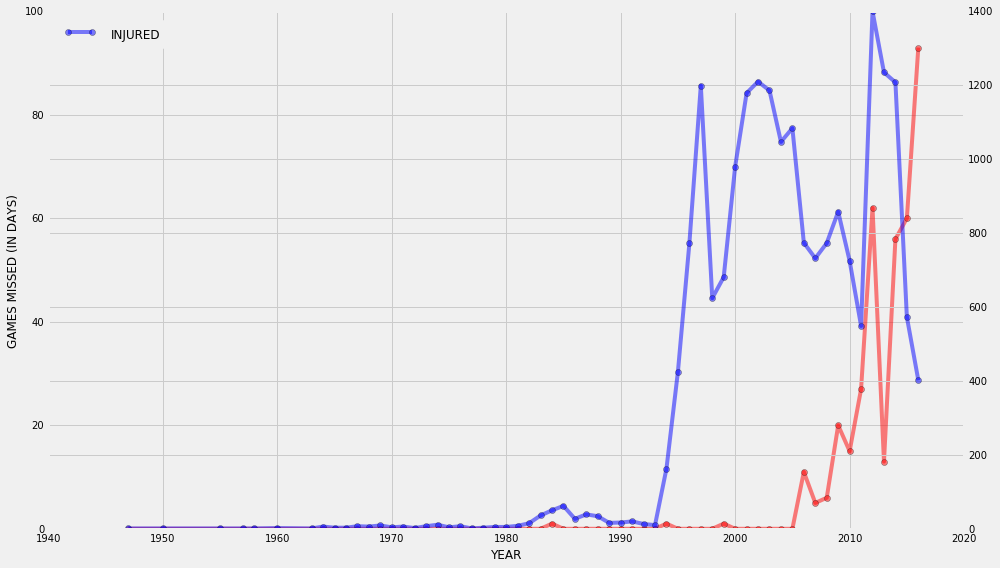

In [72]:
with plt.style.context('fivethirtyeight'):
    fig, ax1 = plt.subplots(figsize=(14, 8))
    ax1.plot(grouped.index, grouped['REST'], marker='o', c='r', alpha=.5, label='REST')
    
    ax2 = ax1.twinx()
    ax2.plot(grouped.index, grouped['INJURED'], marker='o', c='b', alpha=.5, label='INJURED')
    ax1.set_xlabel('YEAR')
    ax1.set_ylabel('GAMES MISSED (IN DAYS)')
    ax1.legend(loc='best')
    ax2.legend(loc='best')
    fig.savefig('images/dnp_rest.png', bbox_inches='tight')

In [8]:
with open('data/feat_mat.pickle', 'r') as f:
    feat_mat = pickle.load(f)

In [9]:
Xy = feat_mat.drop(['PLAYER', 'PLAYER_ID', 'FG3M', 'Season Dates',
                    'FGM', 'FTM', 'BLK', 'PLUS_MINUS', 'START_SEASON',
                    'PTS', 'REB', 'GAMES_PLAYED', 'PLAYER_ID_PACE',
                    'PLAYER_ID_TRACKING', 'BACK_TO_BACKS', 'PACE', 'MIN',
                    'B2B_PLAYED_IN_WINDOW',
                    'FGA', 'MILES_TRAVELED'], axis=1)
Xy.dropna(inplace=True)
Xy.reset_index(inplace=True, drop=True)
Xy = Xy[Xy['SPD'] != 0.0]
Xy.rename(columns={'TOTAL_MILES_TRAVELED': 'MILES TRAVELED',
                   'SPD': 'SPEED',
                   'DIST': 'DISTANCE',
                   'AST': 'ASSISTS',
                   'DREB': 'DEF. REBOUNDS',
                   'OREB': 'OFF. REBOUNDS',
                   'PF': 'FOULS',
                   'STL': 'STEALS',
                   'TOV': 'TURNOVERS',
                   'FTA': 'F.T. ATTEMPTED',
                   'FG3A': '3-PTS ATTEMPTED',
                   'GAMES_PLAYED_IN_WINDOW': 'GAMES PLAYED'},
          inplace=True)

y = Xy['INJURED']
X = Xy.drop('INJURED', axis=1)

X_train, X_holdout, y_train, y_holdout = train_test_split(X, y, test_size=.3)
X_subtrain, X_subtest, y_subtrain, y_subtest = train_test_split(X_train, y_train, test_size=.3)

In [75]:
pd.scatter_matrix(Xy, figsize=(100, 100));
plt.savefig('images/scatter_matrix.png')

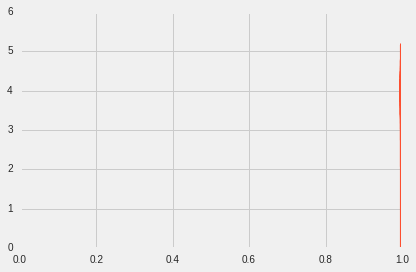

In [26]:
with plt.style.context('fivethirtyeight'):
    plt.plot(feat_mat[feat_mat['INJURED'] == 0]['INJURED'], feat_mat[feat_mat['INJURED'] == 0]['SPD'])
    plt.plot(feat_mat[feat_mat['INJURED'] == 1]['INJURED'], feat_mat[feat_mat['INJURED'] == 1]['SPD'])
    plt.show()